# Retirement Planner

---

## Environment Setup

In [1]:
# Import libraries and dependencies
import numpy as np
import pandas as pd
import os
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import alpaca_trade_api as tradeapi
%matplotlib inline

In [2]:
# Set the random seed for resutls reproducibility (for testing purposes only)
np.random.seed(3)

---

## Portfolio Planner

In this activity, you will use the Alpaca API to grab historical data for a `60/40` portfolio using `SPY` to represent the stock portion and `AGG` to represent the bonds.

In [3]:
# Load .env enviroment variables
from dotenv import load_dotenv
load_dotenv()

# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

# Data Collection

In this step, you will need to use the Alpaca api to fetch closing prices for the `SPY` and `AGG` tickers. Save the results as a pandas DataFrame

In [4]:
# Subset your tickers, then pull returns data:
# Set the ticker
ticker = ["SPY", "AGG"]

# Set timeframe to '1D'
timeframe = "1D"

# Set start and end datetimes of 1 year, between now and 365 days ago.
start_date = pd.Timestamp('2019-01-01', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2019-12-31', tz='America/New_York').isoformat()

# Get 1 year's worth of historical data for SPY and AGG
df = api.get_barset(
    ticker,
    timeframe,
    limit=None,
    start=start_date,
    end=end_date,
    after=None,
    until=None,
).df

# Drop unnecessary columns
df = df.drop(
    columns=['open', 'high', 'low', 'volume'],
    level=1
)

In [5]:
# Display sample data
df.tail()

,AGG,SPY
,close,close
time,,
2019-12-24 00:00:00-05:00,112.375,321.26
2019-12-26 00:00:00-05:00,112.480,322.91
2019-12-27 00:00:00-05:00,112.620,322.86
2019-12-30 00:00:00-05:00,112.630,321.10
2019-12-31 00:00:00-05:00,112.370,321.92


---

## Monte Carlo Simulation

In this step, you will run Monte Carlo Simulations for your portfolio to model portfolio performance at different retirement ages. 

Complete the following steps:

1. Calculate the daily returns for the SPY and AGG closing prices.

2. Calculate volatility for both the SPY and AGG closing prices.

3. Find the last day's closing price for both stocks and save those as variables

4. Run a Monte Carlo Simulation of at least `100` iterations and generate at least `30` years of closing prices

**Hint:** There are `252` trading days per year, so the number of records to generate for each Monte Carlo run will be `252 days * 30 years`.

In [6]:
# Calculate the daily roi for the stocks
daily_returns = df.pct_change()

# Display sample data
daily_returns.head()

,AGG,SPY
,close,close
time,,
2019-01-02 00:00:00-05:00,NaN,NaN
2019-01-03 00:00:00-05:00,0.004081,-0.021730
2019-01-04 00:00:00-05:00,-0.003037,0.032521
2019-01-07 00:00:00-05:00,-0.002109,0.007884
2019-01-08 00:00:00-05:00,-0.000470,0.008844


In [7]:
# Compute daily volatility and avg return 
avg_daily_return_agg = daily_returns.mean()["AGG"]["close"]
print (f"Avg daily return of AGG : {avg_daily_return_agg}")

avg_daily_return_spy = daily_returns.mean()["SPY"]["close"]
print (f"Avg daily return of SPY : {avg_daily_return_spy}")

std_dev_daily_return_agg = daily_returns.std()["AGG"]["close"]
print (f"Daily Std deviation of AGG : {std_dev_daily_return_agg}")

std_dev_daily_return_spy = daily_returns.std()["SPY"]["close"]
print (f"Daily Std deviation of SPY : {std_dev_daily_return_spy}")

Avg daily return of AGG : 0.00021277231473764173
Avg daily return of SPY : 0.0010401250682146959
Daily Std deviation of AGG : 0.002089826211646555
Daily Std deviation of SPY : 0.007820053413439366


In [8]:
# Save the last day's closing price
agg_last_price = df["AGG"]["close"][-1]
spy_last_price = df["SPY"]["close"][-1]

In [9]:
# Setup the Monte Carlo Parameters
number_simulations = 500
number_records = 252 * 30
monte_carlo = pd.DataFrame()
simulated_price_df = pd.DataFrame()

In [10]:
# Run the Monte Carlo Simulation
# Run the simulation of projecting stock prices for the next trading year, `500` times
for n in range(number_simulations):

    # Initialize the simulated prices list with the last closing price of `AGG` and `SPY`
    simulated_agg_prices = [agg_last_price]
    simulated_spy_prices = [spy_last_price]
    
    # Simulate the returns for 252 * 30 days
    for i in range(number_records):
        
        # Calculate the simulated price using the last price within the list
        simulated_agg_price = simulated_agg_prices[-1] * (1 + np.random.normal(avg_daily_return_agg, std_dev_daily_return_agg))
        simulated_spy_price = simulated_spy_prices[-1] * (1 + np.random.normal(avg_daily_return_spy, std_dev_daily_return_spy))
        
        # Append the simulated price to the list
        simulated_agg_prices.append(simulated_agg_price)
        simulated_spy_prices.append(simulated_spy_price)
    
    # Append a simulated prices of each simulation to DataFrame
    simulated_price_df["AGG prices"] = pd.Series(simulated_agg_prices)
    simulated_price_df["SPY prices"] = pd.Series(simulated_spy_prices)
    
    # Calculate the daily returns of simulated prices
    simulated_daily_returns = simulated_price_df.pct_change()
    
    # Set the portfolio weights (40% AGG; 60% SPY)
    weights = [0.40, 0.60]

    # Use the `dot` function with the weights to multiply weights with each column"s simulated daily returns
    portfolio_daily_returns = simulated_daily_returns.dot(weights)
    
    # Calculate the normalized, cumulative return series
    monte_carlo[n] = (1 + portfolio_daily_returns.fillna(0)).cumprod()


In [11]:
# Check that the simulation ran successfully
monte_carlo.tail()

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
7556,115.078243,133.852875,321.816137,188.746433,135.553102,277.261264,153.210846,280.988680,120.688219,98.327141,...,554.819530,130.564253,140.603191,148.842087,86.262140,180.209846,249.108905,170.305567,173.803917,97.666288
7557,115.633548,134.115228,319.089313,188.050520,135.827515,276.328760,153.176106,279.240785,120.501772,98.163678,...,556.223200,130.352122,140.396181,149.252786,86.266987,179.261928,251.061802,169.544114,172.339918,97.475915
7558,116.053194,134.737425,319.131093,188.645871,136.128856,276.923699,152.211457,280.268798,120.963831,97.996465,...,556.475259,130.425381,140.573081,149.976685,86.859203,178.190895,251.633808,170.003624,172.140849,98.142008
7559,115.432867,134.859102,323.005065,188.788338,137.770729,277.591715,153.087817,281.183961,120.673137,97.454239,...,559.908687,128.952116,141.011976,150.104751,87.151247,179.635034,251.245130,170.817438,172.168442,98.300553
7560,116.126985,134.442781,324.918753,188.996433,137.859684,279.472620,154.139604,280.713402,120.490386,97.389023,...,565.858062,128.527270,141.379780,149.026370,86.084701,180.746114,250.844707,170.616452,171.883233,99.069848


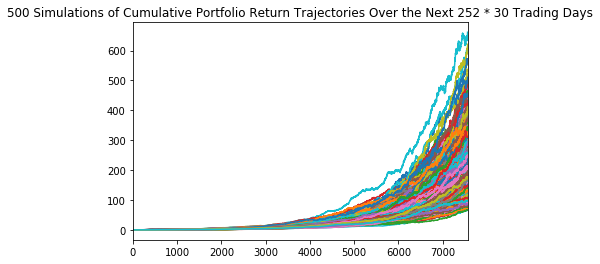

In [12]:
# Visualize the Simulation
plot_title = f"{n+1} Simulations of Cumulative Portfolio Return Trajectories Over the Next 252 * 30 Trading Days"
monte_carlo.plot(legend=None, title=plot_title)

In [13]:
# Select the last row for the cumulative returns (cumulative returns at 30 years)
ending_cumulative_returns = monte_carlo.iloc[-1, :]
ending_cumulative_returns.head()

0    116.126985
1    134.442781
2    324.918753
3    188.996433
4    137.859684
Name: 7560, dtype: float64

In [14]:
# Display the 90% confidence interval for the ending returns
confidence_interval = ending_cumulative_returns.quantile(q=[0.05, 0.95])
print (confidence_interval)

0.05     99.132936
0.95    405.006484
Name: 7560, dtype: float64


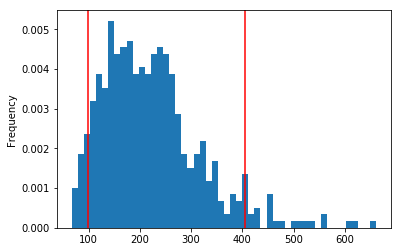

In [15]:
# Visualize the distribution of the ending returns
plt.figure();
ending_cumulative_returns.plot(kind="hist", density=True, bins=50)
plt.axvline(confidence_interval.iloc[0], color="r")
plt.axvline(confidence_interval.iloc[1], color="r")

---

## Retirement Analysis

In this section, you will use the monte carlo model to answer the following retirement planning questions:

1. What are the expected cumulative returns at `30` years for the `10th`, `50th`, and `90th` percentiles?

2. Given an initial investment of `$20,000`, what is the expected return in dollars at the `10th`, `50th`, and `90th` percentiles?

3. Given the current projected annual income from the Plaid analysis, will a `4%` withdrawal rate meet or exceed that value at the `10th` percentile? Note: This is basically determining if retirement income is equivalent to current income.

4. How would a `50%` increase in the initial investment amount affect the `4%` retirement withdrawal? In other words, what happens if the initial investment had been bigger?

### What are the expected cumulative returns at 30 years for the 10th, 50th, and 90th percentiles?

In [16]:
# Compute cumulative returns
cumulative_return_confidence = ending_cumulative_returns.quantile(q=[0.10, 0.50, 0.90])
print(cumulative_return_confidence)

0.1    115.280058
0.5    208.810750
0.9    344.524688
Name: 7560, dtype: float64


### Given an initial investment of `$20,000`, what is the expected portfolio return in dollars at the 10th, 50th, and 90th percentiles?

In [17]:
# Set initial investment
initial_investment = 20000

# Calculate investment profit/loss of lower and upper bound cumulative portfolio returns
investment_pnl_10percent_bound = (initial_investment * cumulative_return_confidence.iloc[0])
investment_pnl_50percent_bound = (initial_investment * cumulative_return_confidence.iloc[1])
investment_pnl_90percent_bound = (initial_investment * cumulative_return_confidence.iloc[2])
                                                    
# Print the results
print(f"There is a chance that an initial investment of $20,000 in the portfolio"
      f" over the next 252 * 30 trading days will end within the"
      f" 10 percentile range of ${investment_pnl_10percent_bound}, 50 percentile range of ${investment_pnl_50percent_bound} or 90 percentile range of ${investment_pnl_90percent_bound}")


There is a chance that an initial investment of $20,000 in the portfolio over the next 252 * 30 trading days will end within the 10 percentile range of $2305601.150673056, 50 percentile range of $4176214.998429308 or 90 percentile range of $6890493.752890138


### Given the current projected annual income from the Plaid analysis, will a 4% withdraw rate from the retirement portfolio meet or exceed that value at the 10th percentile?

Note: This is effectively saying that 90% of the expected returns will be greater than the return at the 10th percentile, so this can help measure the uncertainty about having enough funds at retirement

In [19]:
# Set Plaid's projected income
# To be conservative - Calculation is done based on projected before tax income 
projected_yearly_income_before_tax = 7389

# Calculate the 4% withdrawal for the ending return as retirement income
retirement_income = investment_pnl_10percent_bound * .04

# Determine if the retirement income meets or exceeds the current projected income
if retirement_income > projected_yearly_income_before_tax: 
    print (f"Retirement income {retirement_income} is more than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")
else:
    print (f"Retirement income {retirement_income} is less than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")


Retirement income 92224.04602692224 is more than the projected income 7389 at 10% confidence internal


### How would a 50% increase in the initial investment amount affect the 4% retirement withdrawal?

In [20]:
# Re-calculate the retirement income with a 50% increase in the initial investment amount

retirement_income_50_percent_increase = (initial_investment * cumulative_return_confidence.iloc[0]) * .04 * 1.5

if retirement_income_50_percent_increase > projected_yearly_income_before_tax:
    print (f"Retirement income {retirement_income_50_percent_increase} is more than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")
else:
    print (f"Retirement income {retirement_income_50_percent_increase} is less than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")


Retirement income 138336.06904038336 is more than the projected income 7389 at 10% confidence internal


### Optional Challenge

Use the Monte Carlo data and calculate the cumulative returns at the `5%`, `50%`, and `95%` quartiles and plot this data as a line chart to see how the cumulative returns change over the life of the investment.

In this section, you need to calculate and plot the cumulative returns for the median and `90%` confidence intervals. This plot shows the expected cumulative returns for any given day between the first day and the last day of investment. 

In [232]:
# Compute projected returns
projected_return_5_50_95 = monte_carlo.quantile(q=[0.05, 0.50, 0.95], axis = 1)

# Display sample data
projected_return_5_50_95.head()

,0,1,2,3,4,5,6,7,8,9,...,7551,7552,7553,7554,7555,7556,7557,7558,7559,7560
0.05,1.0,0.993414,0.989885,0.987454,0.987124,0.984833,0.983551,0.983637,0.982287,0.983893,...,99.218620,99.493015,99.356289,99.625088,100.109022,99.809107,98.225392,98.136347,98.481333,99.132936
0.50,1.0,1.000892,1.001756,1.003054,1.003282,1.004353,1.004217,1.005183,1.004928,1.005624,...,207.612839,207.635138,207.573975,207.739730,207.746879,207.406685,207.595115,207.732507,208.397712,208.810750
0.95,1.0,1.008464,1.013435,1.016785,1.019298,1.021795,1.023239,1.024109,1.028358,1.030591,...,398.060963,398.705511,399.459811,401.457817,404.595030,404.431105,404.271151,403.607054,404.858230,405.006484


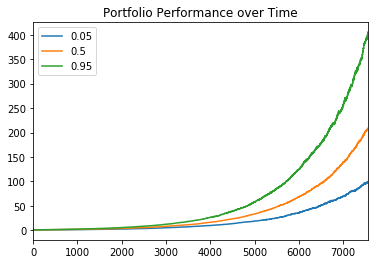

In [233]:
# Plot the cumulative returns over time
projected_return_5_50_95 = projected_return_5_50_95.transpose()

projected_return_5_50_95.plot(title= "Portfolio Performance over Time")

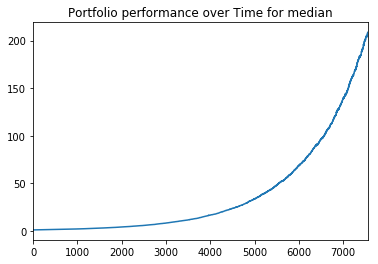

In [28]:
# Plot median cumulative returns over time
projected_return_median = monte_carlo.median(axis=1)
projected_return_median.plot(title = "Portfolio performance over Time for median")

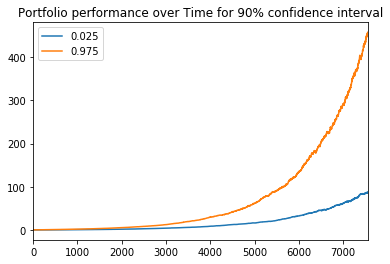

In [23]:
# Plot 90% confidence interval cumulative returns over time

projected_return_90 = monte_carlo.quantile(q=[0.025, 0.975], axis = 1)
projected_return_90 = projected_return_90.transpose()

projected_return_90.plot(title= "Portfolio performance over Time for 90% confidence interval")

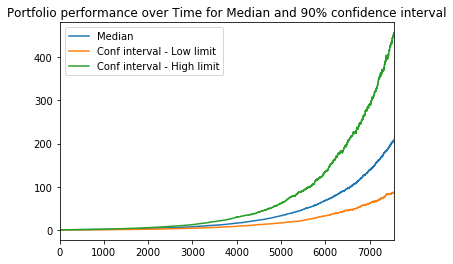

In [33]:
comb_median_90_conf_interval = pd.concat([projected_return_median,projected_return_90], join = "inner",axis = 1)
comb_median_90_conf_interval.columns = ["Median", "Conf interval - Low limit", "Conf interval - High limit"]
comb_median_90_conf_interval.plot(title= "Portfolio performance over Time for Median and 90% confidence interval")

## Retirement Analysis - Assuming Harold wants to retire in 5 years

### Running the required monte-carlo simulation for 5 years 



In [34]:
# Increasing the stock ratio to 90 percent reducing the bond to 10% 
# Running for 500 number of simulation

option_number_records = 252 * 5
option_monte_carlo = pd.DataFrame()
option_simulated_price_df = pd.DataFrame()

In [35]:
# Run the Monte Carlo Simulation
# Run the simulation of projecting stock prices for the next trading year, `500` times
for n in range(number_simulations):

    # Initialize the simulated prices list with the last closing price of `AGG` and `SPY`
    option_simulated_agg_prices = [agg_last_price]
    option_simulated_spy_prices = [spy_last_price]
    
    # Simulate the returns for 252 * 5 days
    for i in range(option_number_records):
        
        # Calculate the simulated price using the last price within the list
        option_simulated_agg_price = option_simulated_agg_prices[-1] * (1 + np.random.normal(avg_daily_return_agg, std_dev_daily_return_agg))
        option_simulated_spy_price = option_simulated_spy_prices[-1] * (1 + np.random.normal(avg_daily_return_spy, std_dev_daily_return_spy))
        
        # Append the simulated price to the list
        option_simulated_agg_prices.append(option_simulated_agg_price)
        option_simulated_spy_prices.append(option_simulated_spy_price)
    
    # Append a simulated prices of each simulation to DataFrame
    option_simulated_price_df["AGG prices"] = pd.Series(option_simulated_agg_prices)
    option_simulated_price_df["SPY prices"] = pd.Series(option_simulated_spy_prices)
    
    # Calculate the daily returns of simulated prices
    option_simulated_daily_returns = option_simulated_price_df.pct_change()
    
    # Set the portfolio weights (10% AGG; 90% SPY)
    option_weights = [0.10, 0.90]

    # Use the `dot` function with the weights to multiply weights with each column"s simulated daily returns
    option_portfolio_daily_returns = option_simulated_daily_returns.dot(option_weights)
    
    # Calculate the normalized, cumulative return series
    option_monte_carlo[n] = (1 + option_portfolio_daily_returns.fillna(0)).cumprod()

In [36]:
option_monte_carlo.head()

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.996760,1.001632,0.987415,0.993398,0.993841,1.010906,0.996535,1.008832,0.987131,0.997866,...,1.006079,1.006164,1.001497,1.003788,0.994010,0.997473,0.996387,1.004817,0.994280,1.006171
2,0.990300,0.990849,0.984794,0.987321,0.995671,1.010108,1.009785,1.013333,0.992198,0.997057,...,0.999096,1.005266,1.000036,0.995801,0.999029,1.003610,0.995576,1.003572,0.994540,1.003761
3,0.998278,0.985414,0.985822,0.983584,0.998904,1.016226,1.006727,1.007360,0.977508,0.989136,...,0.996331,1.010497,0.989848,0.989552,0.985521,1.000666,0.989951,1.008327,0.999707,1.004956
4,0.996905,0.979213,0.992096,0.985769,0.993269,1.009487,1.002729,1.009436,0.978391,0.980023,...,1.005728,1.014009,0.988680,0.999033,0.982287,1.002023,0.983531,1.013756,1.014398,1.005340


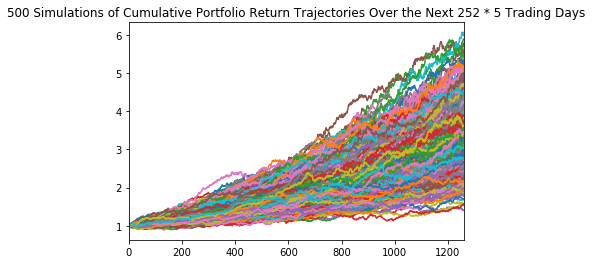

In [37]:
option_title = f"{n+1} Simulations of Cumulative Portfolio Return Trajectories Over the Next 252 * 5 Trading Days"
option_monte_carlo.plot(legend=None, title=option_title)

## Retirement Analysis - Assuming Harold wants to retire in 5 years instead of 30 years 

In this section - Following options are considered 

Option 1 - Increased Equity weight to 90% and Bond weight is reduced to 10%

Option 2 - In this option - Initial investment is increased to $ 50,000 and Equity index weight is increased to 90% 

Option 3 - In this option - Initial investment is increased to $ 85,000 and Equity index weight is increased to 90% 

In [42]:
# Option 1 - Increased Equity weight to 90% and Bond weight is reduced to 10%

option_ending_cumulative_returns = option_monte_carlo.iloc[-1, :]

option_cumulative_return_confidence = option_ending_cumulative_returns.quantile(q=[0.1, 0.5, 0.9])

option_1_investment_pnl_10percent_bound = (initial_investment * option_cumulative_return_confidence.iloc[0])
option_1_investment_pnl_50percent_bound = (initial_investment * option_cumulative_return_confidence.iloc[1])
option_1_investment_pnl_90percent_bound = (initial_investment * option_cumulative_return_confidence.iloc[2])
                                                    
# Print the results
print(f"There is a chance that an initial investment of $20,000 in the portfolio"
      f" over the next 252 * 5 trading days will end within the "
      f" 10 percentile range of ${option_1_investment_pnl_10percent_bound}, 50 percentile range of ${option_1_investment_pnl_50percent_bound} or 90 percentile range of ${option_1_investment_pnl_90percent_bound}")

print("\n")
option_1_retirement_income = option_1_investment_pnl_10percent_bound * .04

# Determine if the retirement income meets or exceeds the current projected income
if option_1_retirement_income > projected_yearly_income_before_tax: 
    print (f"Retirement income for first option {option_1_retirement_income} is more than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")
else:
    print (f"Retirement income for first option {option_1_retirement_income} is less than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")


There is a chance that an initial investment of $20,000 in the portfolio over the next 252 * 5 trading days will end within the  10 percentile range of $46144.95396229987, 50 percentile range of $64997.47388409471 or 90 percentile range of $90025.58036913707


Retirement income for first option 1845.7981584919949 is less than the projected income 7389 at 10% confidence internal


In [43]:
# Option 2 - In this option - Initial investment is increased to $ 50,000 and Equity index weight is increased to 90%

option_2_investment = 50000

option_2_investment_pnl_10percent_bound = (option_2_investment * option_cumulative_return_confidence.iloc[0])
option_2_investment_pnl_50percent_bound = (option_2_investment * option_cumulative_return_confidence.iloc[1])
option_2_investment_pnl_90percent_bound = (option_2_investment * option_cumulative_return_confidence.iloc[2])
                                                    
# Print the results
print(f"There is a chance that an initial investment of $50,000 in the portfolio"
      f" over the next 252 * 5 trading days will end within the "
      f" 10 percentile range of ${option_2_investment_pnl_10percent_bound}, 50 percentile range of ${option_2_investment_pnl_50percent_bound} or 90 percentile range of ${option_2_investment_pnl_90percent_bound}")

print("\n")
option_2_retirement_income = option_2_investment_pnl_10percent_bound * .04

# Determine if the retirement income meets or exceeds the current projected income
if option_2_retirement_income > projected_yearly_income_before_tax: 
    print (f"Retirement income for second option {option_2_retirement_income} is more than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")
else:
    print (f"Retirement income for second option {option_2_retirement_income} is less than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")


There is a chance that an initial investment of $50,000 in the portfolio over the next 252 * 5 trading days will end within the  10 percentile range of $115362.38490574968, 50 percentile range of $162493.68471023676 or 90 percentile range of $225063.95092284266


Retirement income for second option 4614.495396229988 is less than the projected income 7389 at 10% confidence internal


In [45]:
# Option 3 - In this option - Initial investment is increased to $ 85,000 and Equity index weight is increased to 90%

option_3_investment = 85000

option_3_investment_pnl_10percent_bound = (option_3_investment * option_cumulative_return_confidence.iloc[0])
option_3_investment_pnl_50percent_bound = (option_3_investment * option_cumulative_return_confidence.iloc[1])
option_3_investment_pnl_90percent_bound = (option_3_investment * option_cumulative_return_confidence.iloc[2])
                                                    
# Print the results
print(f"There is a chance that an initial investment of $85,000 in the portfolio"
      f" over the next 252 * 5 trading days will end within the "
      f" 10 percentile range of ${option_3_investment_pnl_10percent_bound}, 50 percentile range of ${option_3_investment_pnl_50percent_bound} or 90 percentile range of ${option_3_investment_pnl_90percent_bound}")

print("\n")
option_3_retirement_income = option_3_investment_pnl_10percent_bound * .04

# Determine if the retirement income meets or exceeds the current projected income
if option_3_retirement_income > projected_yearly_income_before_tax: 
    print (f"Retirement income for third option {option_3_retirement_income} is more than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")
else:
    print (f"Retirement income for third option {option_3_retirement_income} is less than the projected income {projected_yearly_income_before_tax} at 10% confidence internal")



There is a chance that an initial investment of $85,000 in the portfolio over the next 252 * 5 trading days will end within the  10 percentile range of $196116.05433977445, 50 percentile range of $276239.2640074025 or 90 percentile range of $382608.7165688325


Retirement income for third option 7844.642173590978 is more than the projected income 7389 at 10% confidence internal
